#install detectron2

In [1]:
!pip install -q cython pyyaml==5.1
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 2.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Preparing metadata (setup.py) ... done


In [2]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -q -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 15541, done.
remote: Counting objects: 100% (266/266), done.
remote: Compressing objects: 100% (218/218), done.
remote: Total 15541 (delta 89), reused 193 (delta 48), pack-reused 15275
Receiving objects: 100% (15541/15541), 6.41 MiB | 6.46 MiB/s, done.
Resolving deltas: 100% (11204/11204), done.
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 6.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


#restart session and continue

In [1]:
!pip install -q -U watermark

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.7 MB/s eta 0:00:00


In [2]:
%reload_ext watermark
%watermark -v -p numpy,pandas,pycocotools,torch,torchvision,detectron2

Python implementation: CPython
Python version       : 3.10.12
IPython version      : 7.34.0

numpy      : 1.25.2
pandas     : 2.0.3
pycocotools: 2.0.7
torch      : 2.2.1+cu121
torchvision: 0.17.1+cu121
detectron2 : 0.6



In [3]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import glob
import os
import ntpath
import numpy as np
import cv2
import random
import itertools
import pandas as pd
from tqdm import tqdm
import urllib
import json
import PIL.Image as Image

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'
sns.set(style='whitegrid', palette='muted', font_scale=1.2)
HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]
sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))
rcParams['figure.figsize'] = 12, 8
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

#import data

In [4]:
!gdown --id 1UQesuRhZCeLKEC9WQlNiQiETe_4UgRRa

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:138: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1UQesuRhZCeLKEC9WQlNiQiETe_4UgRRa
To: /content/faces.csv
100% 125k/125k [00:00<00:00, 23.0MB/s]


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
faces_df = pd.read_csv('faces.csv')

In [7]:
len(faces_df)

3350

In [8]:
faces_df.head()

,image_name,width,height,x0,y0,x1,y1
0,00001722.jpg,1333,2000,490,320,687,664
1,00001044.jpg,2000,1333,791,119,1200,436
2,00001050.jpg,667,1000,304,155,407,331
3,00001736.jpg,626,417,147,14,519,303
4,00003121.jpg,626,418,462,60,599,166


#data preprocessing

In [9]:
dataset = []
for index, row in faces_df.iterrows():
    data = {}
    width = row['width']
    height = row['height']
    data['file_name'] = row['image_name']
    data['width'] = width
    data['height'] = height
    data["x_min"] = row['x0']
    data["y_min"] = row['y0']
    data["x_max"] = row['x1']
    data["y_max"] = row['y1']
    data['class_name'] = 'face'
    dataset.append(data)

In [10]:
df = pd.DataFrame(dataset)
df.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
0,00001722.jpg,1333,2000,490,320,687,664,face
1,00001044.jpg,2000,1333,791,119,1200,436,face
2,00001050.jpg,667,1000,304,155,407,331,face
3,00001736.jpg,626,417,147,14,519,303,face
4,00003121.jpg,626,418,462,60,599,166,face


In [11]:
print(df.file_name.unique().shape[0], df.shape[0])

2204 3350


#data exploration

In [12]:
def annotate_image(annotations, resize=True):
    file_name = annotations.file_name.to_numpy()[0]
    img = cv2.cvtColor(cv2.imread(f'drive/MyDrive/images/{file_name}'), cv2.COLOR_BGR2RGB)
    for i, a in annotations.iterrows():
        cv2.rectangle(img, (a.x_min, a.y_min), (a.x_max, a.y_max), (0, 255, 0), 2)
    if not resize:
        return img
    return cv2.resize(img, (384, 384), interpolation = cv2.INTER_AREA)

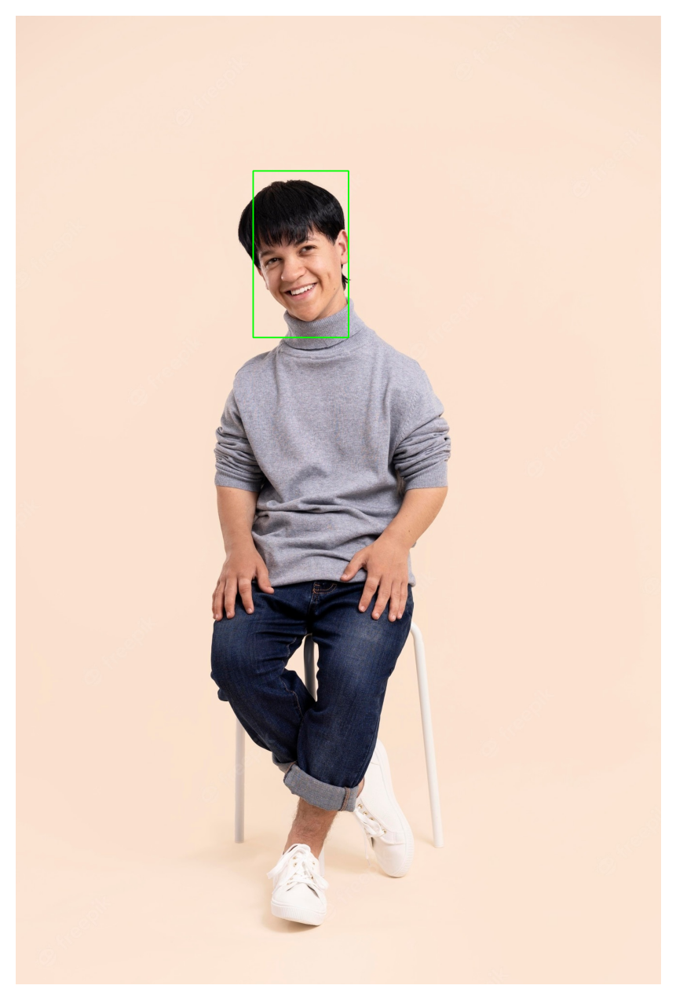

In [13]:
img_df = df[df.file_name == df.file_name.unique()[0]]
img = annotate_image(img_df, resize=False)
plt.imshow(img)
plt.axis('off');

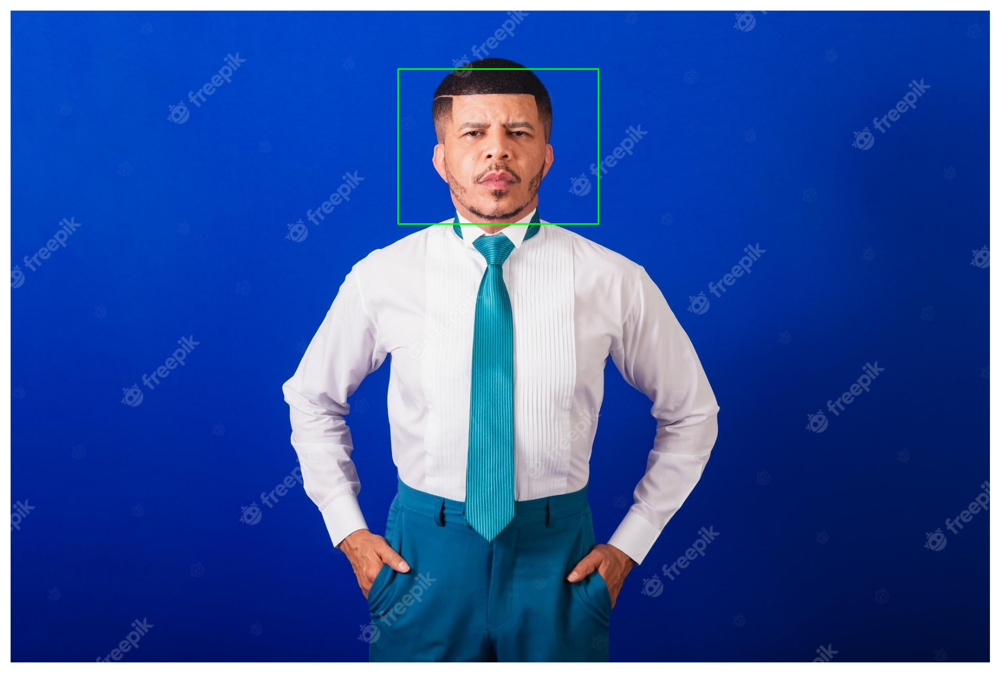

In [14]:
img_df = df[df.file_name == df.file_name.unique()[1]]
img = annotate_image(img_df, resize=False)
plt.imshow(img)
plt.axis('off');

In [15]:
sample_images = [annotate_image(df[df.file_name == f]) for f in df.file_name.unique()[:10]]
sample_images = torch.as_tensor(sample_images)

<ipython-input-15-3b0c6cea6297>:2: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:275.)
  sample_images = torch.as_tensor(sample_images)


In [16]:
sample_images.shape


torch.Size([10, 384, 384, 3])

In [17]:
sample_images = sample_images.permute(0, 3, 1, 2)


In [18]:
sample_images.shape


torch.Size([10, 3, 384, 384])

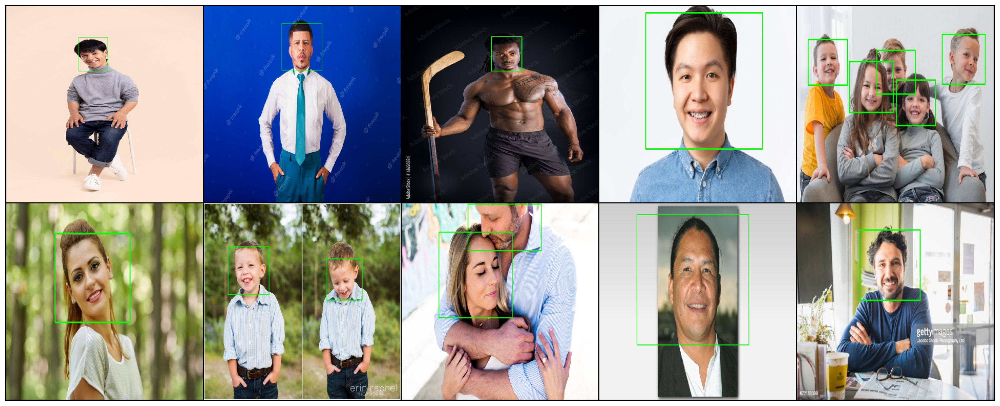

In [19]:
plt.figure(figsize=(24, 12))
grid_img = torchvision.utils.make_grid(sample_images, nrow=5)

plt.imshow(grid_img.permute(1, 2, 0))
plt.axis('off');


#Face Detection with Detectron 2

In [20]:
!nvidia-smi

Fri Apr 19 13:00:48 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [21]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))


Num GPUs Available:  1


In [22]:
unique_files = df.file_name.unique()[:400]

df = df[df['file_name'].isin(unique_files)]

df.shape

(590, 8)

In [23]:
train_files = set(np.random.choice(unique_files, int(len(unique_files) * 0.95), replace=False))
train_df = df[df.file_name.isin(train_files)]
test_df = df[~df.file_name.isin(train_files)]

In [24]:
train_df.shape, test_df.shape

((567, 8), (23, 8))

In [25]:
classes = df.class_name.unique().tolist()

In [26]:
IMAGES_PATH = f'drive/MyDrive/images'

In [27]:
def create_dataset_dicts(df, classes):
    dataset_dicts = []
    for image_id, img_name in enumerate(df.file_name.unique()):
        record = {}
        image_df = df[df.file_name == img_name]
        file_path = f'{IMAGES_PATH}/{img_name}'
        record["file_name"] = file_path
        record["image_id"] = image_id
        record["height"] = int(image_df.iloc[0].height)
        record["width"] = int(image_df.iloc[0].width)
        objs = []
        for _, row in image_df.iterrows():
            xmin = int(row.x_min)
            ymin = int(row.y_min)
            xmax = int(row.x_max)
            ymax = int(row.y_max)
            poly = [
                (xmin, ymin), (xmax, ymin),
                (xmax, ymax), (xmin, ymax)
            ]
            poly = list(itertools.chain.from_iterable(poly))
            obj = {
                "bbox": [xmin, ymin, xmax, ymax],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": classes.index(row.class_name),
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [28]:
for d in ["train", "val"]:
    DatasetCatalog.register("faces_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
    MetadataCatalog.get("faces_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("faces_train")
statement_metadata

namespace(name='faces_train', thing_classes=['face'])

In [29]:
class CocoTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            os.makedirs("coco_eval", exist_ok=True)
            output_folder = "coco_eval"
        return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [30]:
cfg = get_cfg()
cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"
)

In [31]:
cfg.DATASETS.TRAIN = ("faces_train",)
cfg.DATASETS.TEST = ("faces_val",)
cfg.DATALOADER.NUM_WORKERS = 1

In [32]:
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 600
cfg.SOLVER.MAX_ITER = 900
cfg.SOLVER.STEPS = (600, )
cfg.SOLVER.GAMMA = 0.05

In [33]:
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)
cfg.TEST.EVAL_PERIOD = 0   # The period (in terms of steps) to evaluate the model during training. Set to 0 to disable.


In [34]:
cfg.OUTPUT_DIR

'./output'

In [35]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[04/19 13:02:11 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:04, 89.6MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[04/19 13:02:16 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/19 13:04:37 d2.utils.events]:  eta: 1:32:10  iter: 19  total_loss: 1.232  loss_cls: 0.5588  loss_box_reg: 0.5822  loss_rpn_cls: 0.08528  loss_rpn_loc: 0.01223    time: 6.4540  last_time: 4.2241  data_time: 2.4666  last_data_time: 0.0047   lr: 2.5517e-06  max_mem: 10916M
[04/19 13:06:43 d2.utils.events]:  eta: 1:30:04  iter: 39  total_loss: 1.17  loss_cls: 0.5443  loss_box_reg: 0.533  loss_rpn_cls: 0.08664  loss_rpn_loc: 0.01196    time: 6.3810  last_time: 4.4872  data_time: 1.7618  last_data_time: 0.0073   lr: 4.185e-06  max_mem: 10916M
[04/19 13:08:54 d2.utils.events]:  eta: 1:27:58  iter: 59  total_loss: 1.234  loss_cls: 0.5336  loss_box_reg: 0.5702  loss_rpn_cls: 0.0832  loss_rpn_loc: 0.01248    time: 6.4409  last_time: 6.2986  data_time: 1.8623  last_data_time: 1.5366   lr: 5.8183e-06  max_mem: 10916M
[04/19 13:11:01 d2.utils.events]:  eta: 1:25:00  iter: 79  total_loss: 1.232  loss_cls: 0.5027  loss_box_reg: 0.677  loss_rpn_cls: 0.08602  loss_rpn_loc: 0.01381    time: 6.4171  

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[04/19 14:15:00 d2.evaluation.evaluator]: Inference done 11/20. Dataloading: 0.3282 s/iter. Inference: 0.2642 s/iter. Eval: 0.0003 s/iter. Total: 0.5926 s/iter. ETA=0:00:05
[04/19 14:15:05 d2.evaluation.evaluator]: Inference done 18/20. Dataloading: 0.4321 s/iter. Inference: 0.2604 s/iter. Eval: 0.0003 s/iter. Total: 0.6930 s/iter. ETA=0:00:01


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[04/19 14:15:07 d2.evaluation.evaluator]: Total inference time: 0:00:10.628422 (0.708561 s / iter per device, on 1 devices)
[04/19 14:15:07 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.261851 s / iter per device, on 1 devices)
[04/19 14:15:07 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[04/19 14:15:07 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[04/19 14:15:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[04/19 14:15:07 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[04/19 14:15:07 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[04/19 14:15:07 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[04/19 14:15:07 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP

#Evaluating Object Detection Models

In [36]:
%load_ext tensorboard
%tensorboard --logdir output


<IPython.core.display.Javascript object>

In [37]:
# !gdown --id 18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
# !mv face_detector.pth output/model_final.pth

In [52]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

In [53]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85

In [54]:
predictor = DefaultPredictor(cfg)

[04/19 14:25:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [55]:
evaluator = COCOEvaluator("faces_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "faces_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [04/19 14:25:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[04/19 14:25:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[04/19 14:25:09 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[04/19 14:25:09 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[04/19 14:25:09 d2.data.common]: Serialized dataset takes 0.01 MiB
[04/19 14:25:09 d2.evaluation.evaluator]: Start inference on 20 batches


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[04/19 14:25:12 d2.evaluation.evaluator]: Inference done 11/20. Dataloading: 0.0021 s/iter. Inference: 0.2849 s/iter. Eval: 0.0003 s/iter. Total: 0.2873 s/iter. ETA=0:00:02


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[04/19 14:25:15 d2.evaluation.evaluator]: Total inference time: 0:00:04.385288 (0.292353 s / iter per device, on 1 devices)
[04/19 14:25:15 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.283537 s / iter per device, on 1 devices)
[04/19 14:25:15 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[04/19 14:25:15 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[04/19 14:25:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[04/19 14:25:15 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[04/19 14:25:15 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[04/19 14:25:15 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[04/19 14:25:15 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP)

OrderedDict([('bbox',
              {'AP': 31.1725533462967,
               'AP50': 84.15424364681793,
               'AP75': 9.60229636409019,
               'APs': nan,
               'APm': 28.531353135313527,
               'APl': 32.9421122872656})])

#Finding Faces in Images

In [56]:
os.makedirs("annotated_results", exist_ok=True)
test_image_paths = test_df.file_name.unique()

In [57]:
for clothing_image in test_image_paths:
    file_path = f'{IMAGES_PATH}/{clothing_image}'
    im = cv2.imread(file_path)
    outputs = predictor(im)
    v = Visualizer(
        im[:, :, ::-1],
        metadata=statement_metadata,
        scale=1.,
        instance_mode=ColorMode.IMAGE
    )
    instances = outputs["instances"].to("cpu")
    v = v.draw_instance_predictions(instances)
    result = v.get_image()[:, :, ::-1]
    file_name = ntpath.basename(clothing_image)
    write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [58]:
annotated_images = [f'annotated_results/{f}' for f in test_df.file_name.unique()]

In [59]:
len(annotated_images)

20

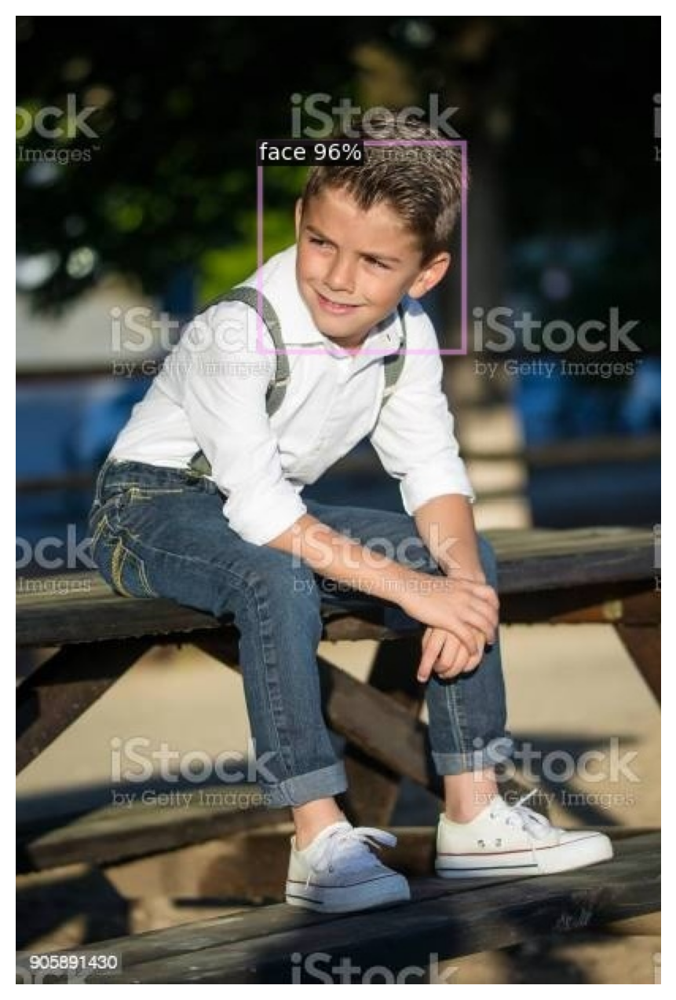

In [60]:
img = cv2.cvtColor(cv2.imread(annotated_images[0]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

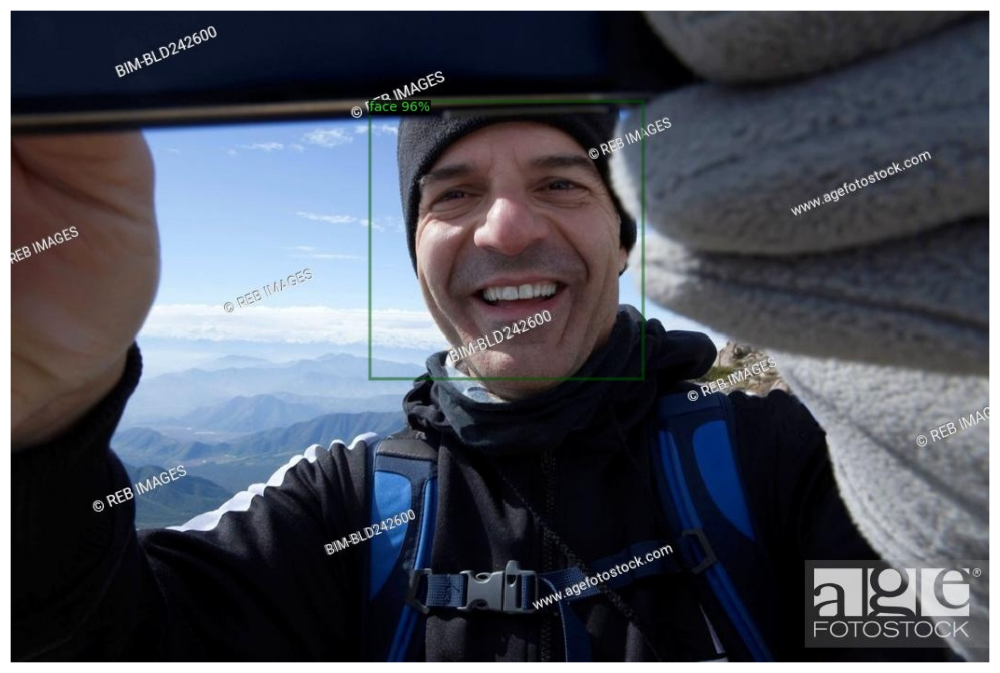

In [61]:
img = cv2.cvtColor(cv2.imread(annotated_images[1]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

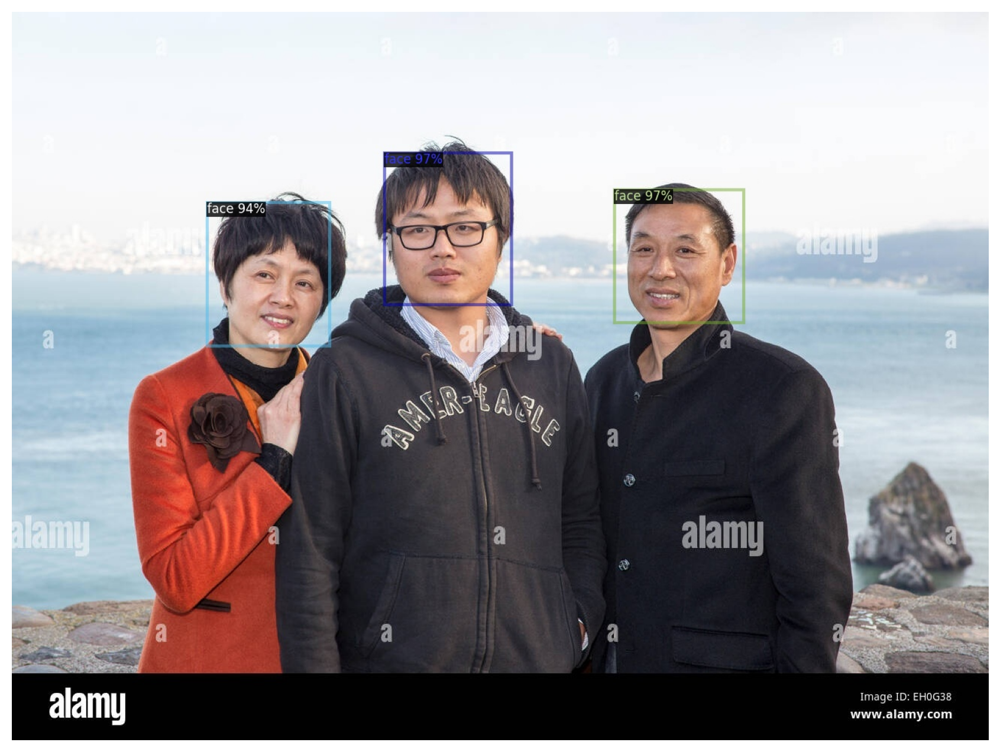

In [62]:
img = cv2.cvtColor(cv2.imread(annotated_images[2]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

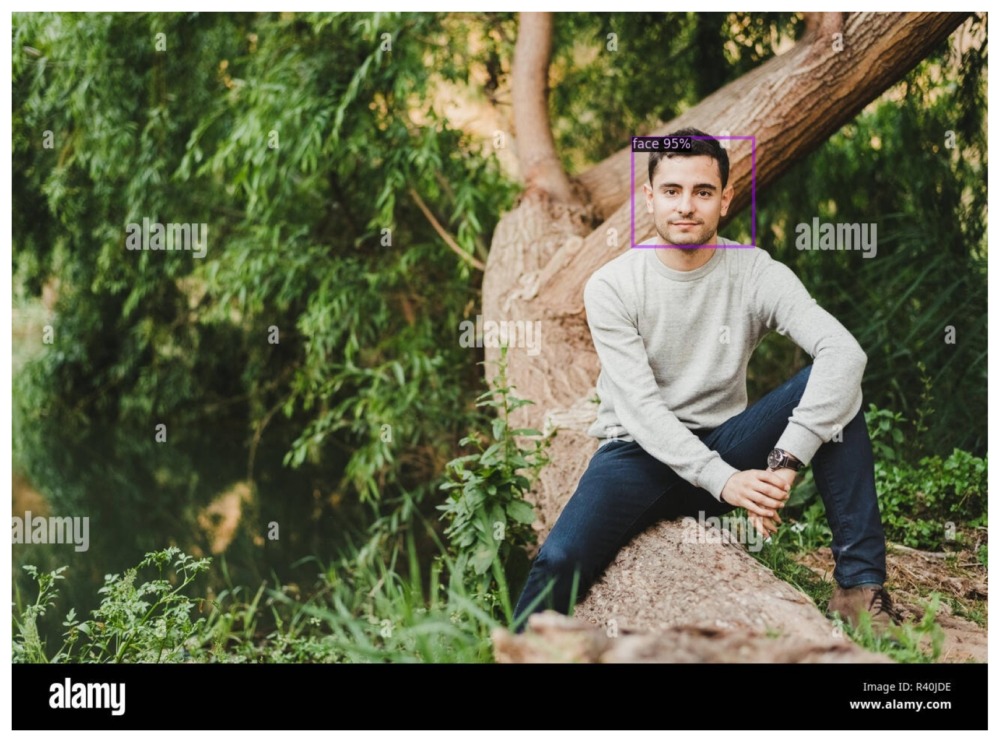

In [63]:
img = cv2.cvtColor(cv2.imread(annotated_images[3]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

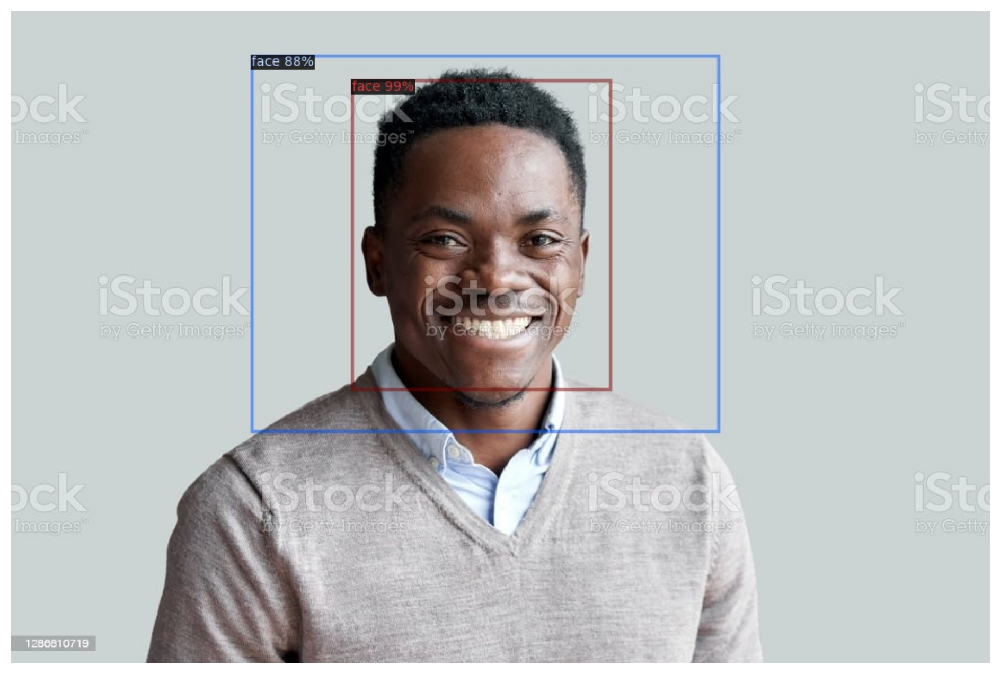

In [64]:
img = cv2.cvtColor(cv2.imread(annotated_images[4]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

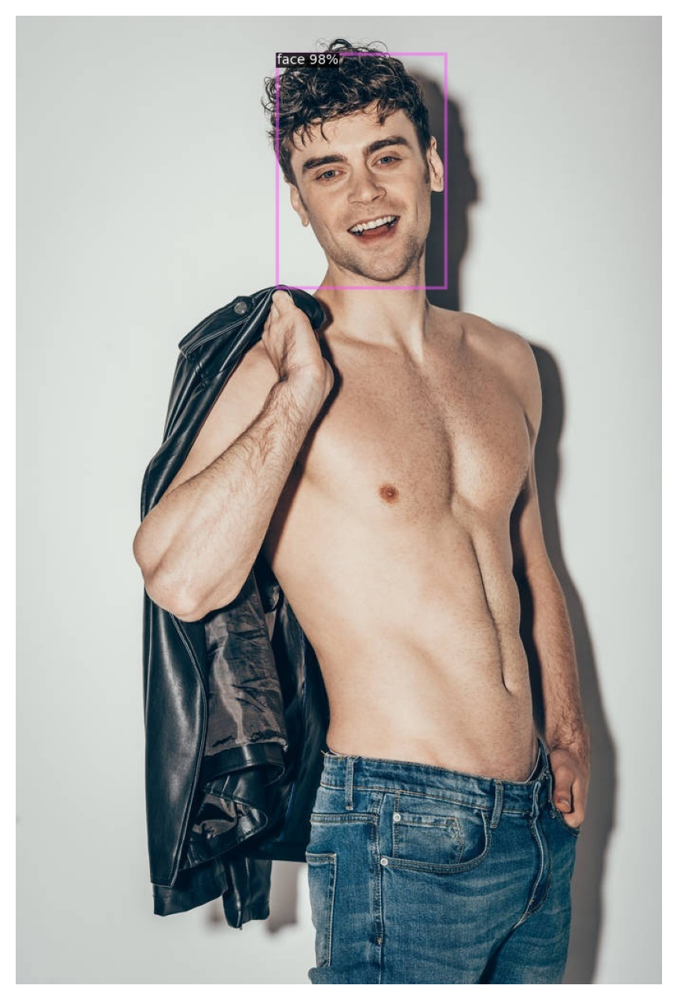

In [65]:
img = cv2.cvtColor(cv2.imread(annotated_images[5]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');